In [1]:
import folium
import csv

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.offline as poff
import plotly.express as px
import networkx as nx

from pyvis.network import Network

In [2]:
gps_data = pd.read_csv("data/tdrive_gps_data.csv")

In [3]:
nodes = pd.read_csv("data/tdrive_nodes.csv")

In [4]:
geohash_data = pd.read_csv("data/tdrive_geohash_size_8.csv")

In [5]:
groupby_geohash = pd.read_csv("data/tdrive_groupby_geohash_size_8.csv")

In [6]:
meet_geohash = pd.read_csv("data/tdrive_meet_geohash_size_8.csv")

In [7]:
meet_edges = pd.read_csv("data/tdrive_meet_edges.csv")

In [8]:
meet_edges_time = pd.read_csv("data/meets/tdrive_meet_edges_size_8_0-120s-0-100times.csv")

In [9]:
meet_edges

,A,B
0,5442,8192
1,5442,8193
2,5442,8194
3,5442,8195
4,5442,8196
...,...,...
40831725,7003,8179
40831726,7003,10228
40831727,7003,9845
40831728,7003,7925


In [10]:
meet_edges_time

,A,B
0,3681,6520
1,2544,2862
2,2544,4494
3,4560,9373
4,9200,10287
...,...,...
612,2343,6801
613,2044,3953
614,4443,5456
615,5160,9196


# 1. Dataset map

In [11]:
gps_data

,Person ID,Timestamp,Longitude,Latitude,Trajectory
0,1,2008-02-02 15:36:08,116.51172,39.92123,20080202153608
1,1,2008-02-02 15:46:08,116.51135,39.93883,20080202153608
2,1,2008-02-02 15:46:08,116.51135,39.93883,20080202153608
3,1,2008-02-02 15:56:08,116.51627,39.91034,20080202153608
4,1,2008-02-02 16:06:08,116.47186,39.91248,20080202153608
...,...,...,...,...,...
13818532,9999,2008-02-08 17:11:13,116.27644,39.99720,20080202133930
13818533,9999,2008-02-08 17:16:15,116.28298,39.99740,20080202133930
13818534,9999,2008-02-08 17:21:17,116.28896,39.99235,20080202133930
13818535,9999,2008-02-08 17:26:19,116.28925,39.98273,20080202133930


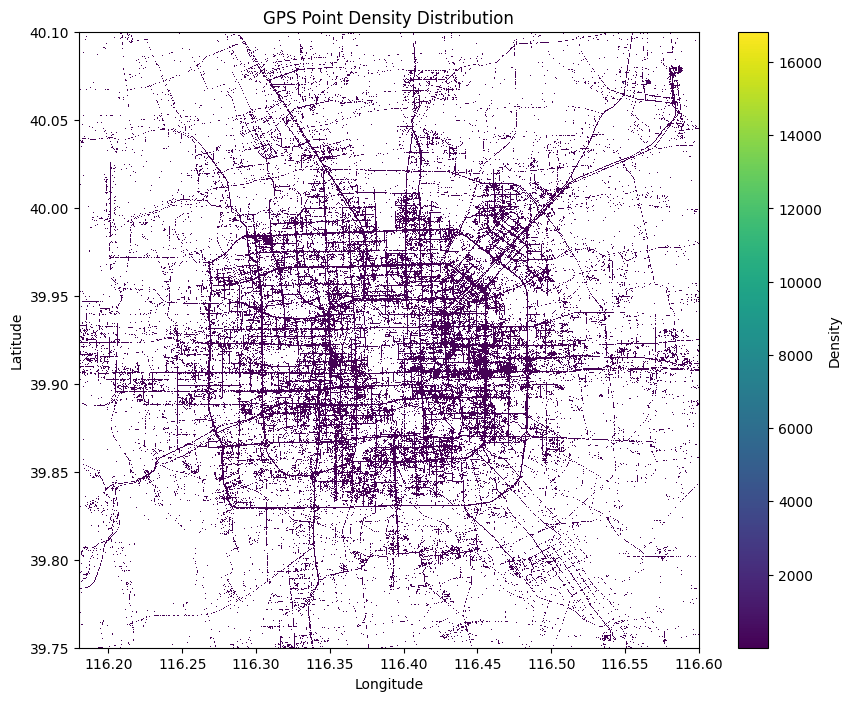

In [12]:
my_map = folium.Map(location=[39.90, 116.41], zoom_start=12)

plt.figure(figsize=(10, 8))
plt.hist2d(gps_data['Longitude'], gps_data['Latitude'], bins=2600, cmap='viridis', cmin=1)
plt.colorbar(label='Density')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('GPS Point Density Distribution')

plt.savefig('images/density_plot_tdrive.png', dpi=300)

plt.show()

# 2. Possible copies of tracks in dataset

In [13]:
groupby_geohash

,Geohash,persons,times,Latitude,Longitude,count_p,count_t,diff_time
0,wx4d5u6g,[7653],"{""7653"": [1202197155000000000]}",39.750450,116.184500,1,1,0
1,wx4d5vmh,[4657],"{""4657"": [1202390061000000000]}",39.756230,116.187550,1,1,0
2,wx4d5wzf,"[5442, 9109, 9921]","{""5442"": [1202327632000000000], ""9109"": [12020...",39.764067,116.180303,3,3,1330805248
3,wx4d5xzu,"[861, 4476, 10282]","{""861"": [1202256864000000000, 1202256870000000...",39.769920,116.180210,3,5,277626880
4,wx4d5y8e,[2162],"{""2162"": [1202000235000000000]}",39.762940,116.181370,1,1,0
...,...,...,...,...,...,...,...,...
586581,wx4uhcp7,[7300],"{""7300"": [1201966190000000000]}",40.084280,116.585900,1,1,0
586582,wx4uhcp9,[3068],"{""3068"": [1202038839000000000]}",40.083930,116.586560,1,1,0
586583,wx4uhcpn,[7300],"{""7300"": [1201966790000000000]}",40.084670,116.585860,1,1,0
586584,wx4uhcqf,[1172],"{""1172"": [1202292919000000000]}",40.085430,116.585230,1,1,0


In [14]:
np.unique([str(x) for x in groupby_geohash[(groupby_geohash['diff_time'] == 0) & (groupby_geohash['count_p'] > 1)]['persons'].values.tolist()])

array(['[1092, 6944]', '[1207, 7212]', '[2032, 5608]', '[2365, 7669]',
       '[2663, 10301]', '[3964, 5671]', '[4443, 5456]', '[5160, 9196]',
       '[5318, 6071]', '[5400, 10116]', '[5961, 7603]', '[6590, 7481]',
       '[6889, 7906]', '[6977, 9151]'], dtype='<U13')

# 3. Heatmap of Meet in Geohash

In [15]:
meet_geohash

,Geohash,persons,times,Latitude,Longitude,count_p,count_t,diff_time
0,wx4d5wzf,"[5442, 9109, 9921]","{""5442"": [1202327632000000000], ""9109"": [12020...",39.764067,116.180303,3,3,1330805248
1,wx4d5xzu,"[861, 4476, 10282]","{""861"": [1202256864000000000, 1202256870000000...",39.769920,116.180210,3,5,277626880
2,wx4d5y8g,"[224, 10177]","{""224"": [1202312439000000000], ""10177"": [12021...",39.762923,116.181763,2,3,257827328
3,wx4d5y8u,"[8170, 10177]","{""8170"": [1202210824000000000], ""10177"": [1202...",39.763055,116.181730,2,2,134980608
4,wx4d5y8x,"[3733, 4476, 9259, 10177]","{""3733"": [1202392650000000000], ""4476"": [12022...",39.763600,116.181310,4,4,1767028224
...,...,...,...,...,...,...,...,...
369646,wx4uhcg6,"[89, 1152, 1340, 3232, 4854, 4967, 5032, 5616,...","{""89"": [1201963365000000000], ""1152"": [1202470...",40.088192,116.580601,10,10,1750968832
369647,wx4uhcg7,"[27, 227, 6526]","{""27"": [1202121289000000000], ""227"": [12020727...",40.088295,116.580433,3,4,1469309440
369648,wx4uhcgd,"[6185, 10073]","{""6185"": [1202321654000000000], ""10073"": [1202...",40.088240,116.580830,2,2,756124672
369649,wx4uhcgf,"[485, 1581, 4057, 8256, 9950]","{""485"": [1201987218000000000], ""1581"": [120198...",40.088240,116.581284,5,5,322914816


## 3.1 Geohash heatmap

In [16]:
import folium
import geohash
import matplotlib.pyplot as plt

df = meet_geohash.copy()

def draw_geohash_rectangles_colored(df):
	cmap = plt.cm.get_cmap('viridis')
	norm = plt.Normalize(vmin=df['count_p'].min(), vmax=df['count_p'].max())
	
	m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=10)

	for index, row in df.iterrows():
		geohash_code = row['Geohash']
		
		bounding_box = geohash.bbox(geohash_code)
		
		min_lat = float(bounding_box['s'])
		min_lon = float(bounding_box['w'])
		max_lat = float(bounding_box['n'])
		max_lon = float(bounding_box['e'])

		center_lat = (min_lat + max_lat) / 2
		center_lon = (min_lon + max_lon) / 2

		color = cmap(norm(row['count_p']))
		color_hex = '#%02x%02x%02x' % tuple(int(255 * rgb) for rgb in color[:3])

		folium.Rectangle(bounds=[[min_lat, min_lon], [max_lat, max_lon]],
						color=color_hex,
						fill=True,
						fill_opacity=0.5,
						tooltip=f'Lat: {center_lat}, Long: {center_lon}').add_to(m)

	return m

m = draw_geohash_rectangles_colored(df)
m.save('./htmls/tdrive_colored_geohash.html')

C:\Users\danstorm\AppData\Local\Temp\ipykernel_8576\1076126583.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



In [17]:
fig = px.density_mapbox(
	meet_geohash, 
	lat='Latitude', 
	lon='Longitude',
	z='count_p',
	radius=10,
	center=dict(lat=meet_geohash['Latitude'].mean(), lon=meet_geohash['Longitude'].mean()),
	zoom=10,
)
fig.update_layout(mapbox_style="open-street-map")
poff.plot(fig, filename='htmls/tdrive_meet_in_geohash_heatmap.html')
fig.show()

# 4. Distribution of meets in Geohash

## 4.1 by number of people

C:\Users\danstorm\AppData\Local\Temp\ipykernel_8576\3085678050.py:11: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



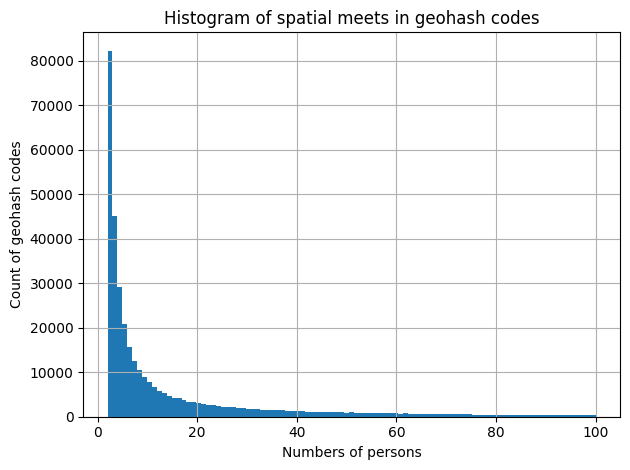

In [18]:
# v kolkych geohash kodoch sa stretlo dany pocet ludi. X - Pocet ludi, Y - pocet geohash
# meet_geohash['count_p'].hist(bins=100, log=True)
f = meet_geohash[(meet_geohash['count_p']<=100) & (meet_geohash['count_p']>=2) ]['count_p'].hist(bins=99, log=False).get_figure()
# v kolkych geohash kodoch sa stretlo dany pocet ludi. X - Pocet ludi, Y - pocet geohash
plt.xlabel('Numbers of persons')
plt.ylabel('Count of geohash codes')
plt.title('Histogram of spatial meets in geohash codes')
# plt.xticks(rotation=60)
plt.tight_layout()
plt.savefig("images/hist_spatial_meets_geolife.png") 
f.show()

C:\Users\danstorm\AppData\Local\Temp\ipykernel_8576\3507104918.py:9: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



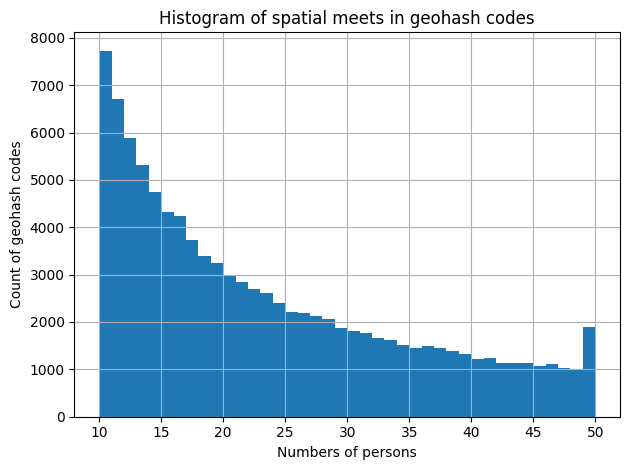

In [19]:
f = meet_geohash[(meet_geohash['count_p']<=50) & (meet_geohash['count_p']>=10) ]['count_p'].hist(bins=40, log=False).get_figure()
# v kolkych geohash kodoch sa stretlo dany pocet ludi. X - Pocet ludi, Y - pocet geohash
plt.xlabel('Numbers of persons')
plt.ylabel('Count of geohash codes')
plt.title('Histogram of spatial meets in geohash codes')
# plt.xticks(rotation=60)
plt.tight_layout()
plt.savefig("images/hist_spatial_meets_geolife_10_to_50.png") 
f.show()

C:\Users\danstorm\AppData\Local\Temp\ipykernel_8576\1937215424.py:9: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



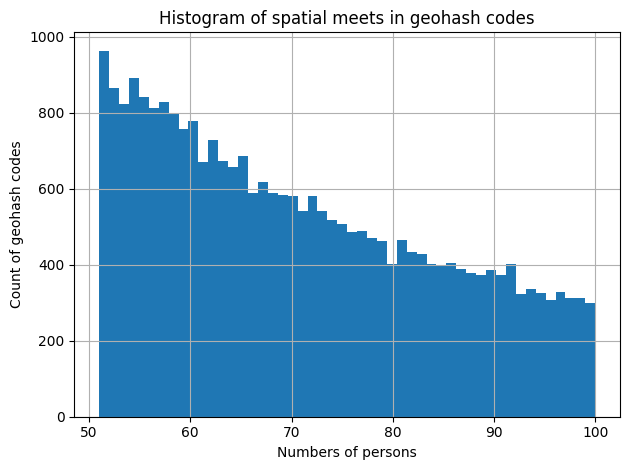

In [20]:
f = meet_geohash[(meet_geohash['count_p']<=100) & (meet_geohash['count_p']>50) ]['count_p'].hist(bins=50, log=False).get_figure()
# v kolkych geohash kodoch sa stretlo dany pocet ludi. X - Pocet ludi, Y - pocet geohash
plt.xlabel('Numbers of persons')
plt.ylabel('Count of geohash codes')
plt.title('Histogram of spatial meets in geohash codes')
# plt.xticks(rotation=60)
plt.tight_layout()
plt.savefig("images/hist_spatial_meets_geolife_50_to_100.png") 
f.show()

## 4.2 by time diff between meet

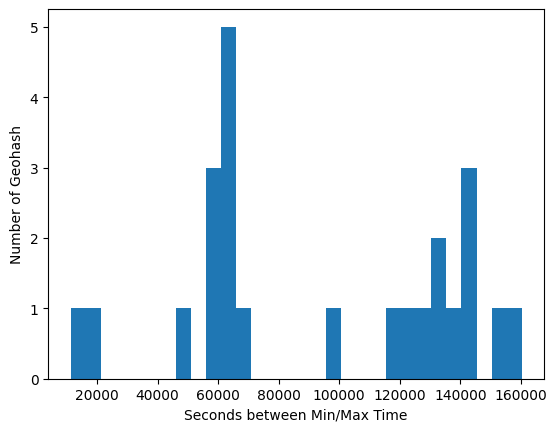

In [21]:
# meet_geohash[(meet_geohash['diff_time']<=200000) & (meet_geohash['diff_time']>0)]['diff_time'].hist(bins=24,log=False) 
# pocet geohash podla min,max casu,  X - sekundy medzi min/max  , Y - pocet geohash

meet_geohash_subset = meet_geohash[(meet_geohash['diff_time'] <= 200000) & (meet_geohash['diff_time'] > 0)]

plt.hist(meet_geohash_subset['diff_time'], bins=30)
plt.xlabel('Seconds between Min/Max Time')
plt.ylabel('Number of Geohash')
plt.show()

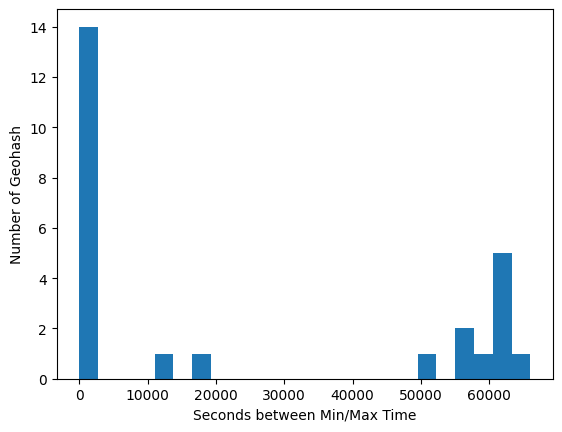

In [22]:
# meet_geohash[(meet_geohash['diff_time']<=60*60*24) & (meet_geohash['diff_time']>=0)]['diff_time'].hist(bins=24,log=False) 
# pocet geohash podla min,max casu,  X - sekundy medzi min/max  , Y - pocet geohash

meet_geohash_subset = meet_geohash[(meet_geohash['diff_time'] <= 60*60*24) & (meet_geohash['diff_time'] >= 0)]

plt.hist(meet_geohash_subset['diff_time'], bins=24)
plt.xlabel('Seconds between Min/Max Time')
plt.ylabel('Number of Geohash')
plt.show()

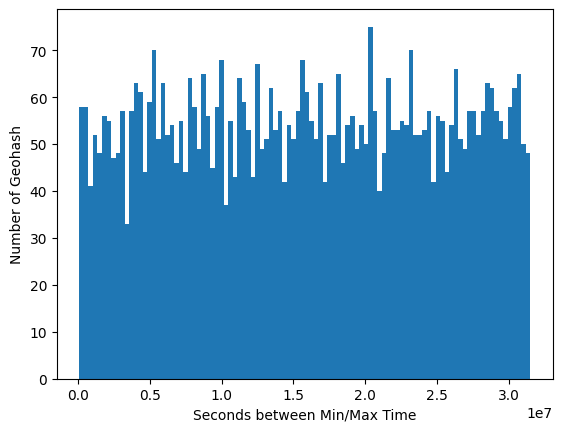

In [23]:
# meet_geohash[(meet_geohash['diff_time']<=365*24*60*60) & (meet_geohash['diff_time']>=24*60*60)]['diff_time'].hist(bins=100) 
# pocet geohash podla min,max casu,  X - dni medzi min/max  , Y - pocet geohash

meet_geohash_subset = meet_geohash[(meet_geohash['diff_time'] <= 365*24*60*60) & (meet_geohash['diff_time'] >=24*60*60)]

plt.hist(meet_geohash_subset['diff_time'], bins=100)
plt.xlabel('Seconds between Min/Max Time')
plt.ylabel('Number of Geohash')
plt.show()

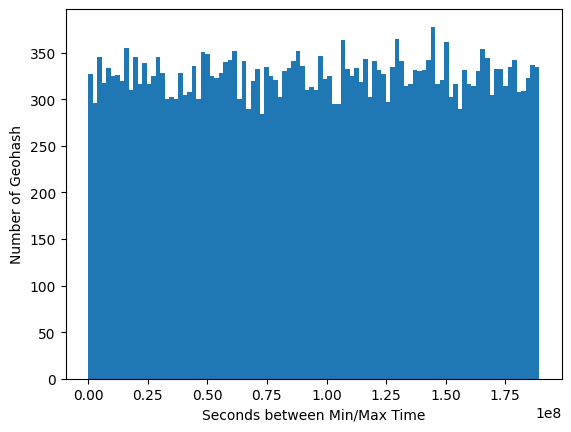

In [24]:
# meet_geohash[meet_geohash['diff_time']<=60*60*24*365*6]['diff_time'].hist(bins=100, log=False)
# pocet geohash podla min,max casu,  X - dni medzi min/max  , Y - pocet geohash

meet_geohash_subset = meet_geohash[meet_geohash['diff_time'] <= 60*60*24*365*6]

plt.hist(meet_geohash_subset['diff_time'], bins=100, log=False)
plt.xlabel('Seconds between Min/Max Time')
plt.ylabel('Number of Geohash')
plt.show()

# 5. Meeting graphs

In [23]:
def visualize_graph(edges, nodes, name):
	G = nx.Graph()
	# G.add_nodes_from(nodes)
	G.add_edges_from(edges)

	nt = Network(directed=False, notebook=True)

	for node in G.nodes:
		nt.add_node(node, title=str(node), label=str(node))

	nt.from_nx(G)

	nt.show('htmls/'+name+'.html')

## 5.1. By geohash without time

In [24]:
meet_edges

,A,B
0,5442,8192
1,5442,8193
2,5442,8194
3,5442,8195
4,5442,8196
...,...,...
40831725,7003,8179
40831726,7003,10228
40831727,7003,9845
40831728,7003,7925


## 5.2. By geohash and time

In [25]:
def load_graph_edges(file_path):
	with open(file_path, 'r') as csvfile:
		reader = csv.reader(csvfile)
		next(reader)
		edges = [tuple(map(int, row)) for row in reader]

	return edges

# def load_nodes(file_path):
# 	with open(file_path, 'r') as csvfile:
# 		reader = csv.reader(csvfile)
# 		next(reader)
# 		nodes = [int(row[0]) for row in reader]

# 	return nodes

In [26]:
graph_edges = load_graph_edges("data/meets/tdrive_meet_edges_size_8_0-120s-0-100times.csv")
# nodes = load_nodes("data/tdrive_nodes.csv")
visualize_graph(graph_edges, nodes, "tdrive_meet_time")

htmls/tdrive_meet_time.html
